In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

# Let's build an attention maps

In [2]:
# !pip install torchsummary

In [3]:
#IMPORTS

import torch
import torchvision
import torchvision.transforms as T
import numpy as np
import matplotlib.pyplot as plt
from torchsummary import summary
import requests
from PIL import Image
import os
import io
import base64

In [4]:
import sys
sys.path.append(os.path.abspath("../../skin_cancer_nas")) # go to parent dir
sys.path.append(os.path.abspath("/mnt/skin_cancer_nas/data"))
sys.path.append(os.path.abspath("/mnt/skin_cancer_nas/data/torch_generator"))
sys.path.append(os.path.abspath("/mnt/skin_cancer_nas/nas/darts_torch"))

sys.path.append('/mnt')
sys.path.append('/mnt/skin_cancer_nas')
sys.path.append('/mnt/skin_cancer_nas/data/torch_generator')
from skin_cancer_nas.data.torch_generator import generator as data_gen
from skin_cancer_nas.data.torch_generator import base_classes

from nas.darts_torch import *
from config import CLASSES_SET
import cv2

In [5]:
import logging
logger = logging.getLogger('skin_cancer_nas__darts__attention_notebook')

### Load model

In [7]:
# Load model
device = 'cpu'

# model = torch.load("/mnt/models/darts_retrained_128x128_nonnorm_2lrs_16ch_5big_classes_newdata_aug1/epoch_229_model1.pt")
model = torch.load("/mnt/models/darts_retrained_128x128_nonnorm_2lrs_16ch_c43_c44_d22_l82_newdata_v2_aug1/epoch_441_model1.pt")

model.to(device)
for param in model.parameters():
    param.requires_grad = False

### Data preparation

In [8]:
partition, labels = data_gen.train_val_split(val_ratio=0.1, classes_list=CLASSES_SET)

def get_input_output_from_path(sample_path, labels):
    '''
    Generates one sample of data
    '''
    try:
        # logger.info('Sample path={}'.format(sample_path))
        x_out = _convert_img_to_array(sample_path)
        x_out = x_out.astype('float32')
        x_out /= 255

        X = torch.as_tensor(x_out)
        y = labels[str(sample_path)]

        X = X.to(device)
        y = torch.tensor(y).to(device)
        return X, y
    except Exception as e:
        msg = 'Something went wrong at path={}, e={}'.format(sample_path, e)
        print(msg)
        logger.info(msg)

VALID_CHANNELS = ['r', 'ir', 'g', 'uv']
IMG_WIDTH = 128
IMG_HEIGHT = 128
VALUE_MISSING = 0
MISSING_CH_IMG = np.ones((IMG_HEIGHT, IMG_WIDTH)) * VALUE_MISSING
def _convert_img_to_array(sample_path):
    'Converts n grayscale images to 3D array with n channels'
    x_array = []
    for channel in VALID_CHANNELS:
        channel_path = os.path.join(sample_path, channel)
        if not os.path.exists(channel_path):
            x_array.append(MISSING_CH_IMG)
            continue
        image = os.listdir(channel_path)
        if not image:
            x_array.append(MISSING_CH_IMG)
            continue
        full_image_path = os.path.join(channel_path, image[0])
        img = cv2.imread(full_image_path, flags=cv2.IMREAD_GRAYSCALE)
        if img is None:
            x_array.append(MISSING_CH_IMG)
            continue
        else:
            shape = img.shape
            # logger.info(shape)
            img = cv2.resize(img, (IMG_HEIGHT, IMG_WIDTH), interpolation=cv2.INTER_CUBIC)

        x_array.append(img)

    return np.stack(x_array, axis=0)

! IMPORTANT ! - for now we don't have any image transformations (like normalization), but once they will be - they have to be added here!

In [9]:
X, y = get_input_output_from_path(sample_path=partition['validation'][0], labels=labels)
# X.requires_grad_()

### Calculate saliency (attention) maps

In [10]:
def get_saliencies(X, model, classes_num):
    '''
    inputs:
        X: - image torch tensor (preprocessed if needed)
        model: torch model
        classes_num: number of classes (last layer size)
    returns:
        saliencies: list of activations (4, img_width, img_height), 4 channels as we have four inputs, these can be summed up for visualization
        score_max_index: winning score index (index of saliency map (and neuron), that had highest output)
    '''
    # Copy input
    X_orig = X.detach().clone()
    
    # we would run the model in evaluation mode
    model.eval()
    saliencies = []
    for score_indx in range(classes_num):
        X = X_orig.detach().clone()
        # we need to find the gradient with respect to the input image, so we need to call requires_grad_ on it
        X.requires_grad_()

        '''
        forward pass through the model to get the scores, note that VGG-19 model doesn't perform softmax at the end
        and we also don't need softmax, we need scores, so that's perfect for us.
        '''
        scores = model(X.unsqueeze(0))

        # Get the index corresponding to the maximum score and the maximum score itself.
        score_max_index = scores.argmax()
        score_to_analize = scores[0, score_indx]

        '''
        backward function on score_max performs the backward pass in the computation graph and calculates the gradient of 
        score_to_analize with respect to nodes in the computation graph
        '''
        score_to_analize.backward()

        '''
        Saliency would be the gradient with respect to the input image now. But note that the input image has 3 channels,
        R, G and B. To derive a single class saliency value for each pixel (i, j),  we take the maximum magnitude
        across all colour channels.
        '''
        # saliency, _ = torch.max(X.grad.data.abs(), dim=0)
    #     saliency = torch.sum(X.grad.data.abs(), dim=0)
        saliencies.append(X.grad.data.abs().detach().numpy())
        
    return saliencies, score_max_index.detach().numpy().item()

In [11]:
# saliencies, score_max_index = get_saliencies(X, model, classes_num=5)

In [12]:
# imshow(np.sum(saliencies[2], axis=0), cmap=plt.cm.hot)

### Gallery

In [13]:
class FlowLayout(object):
    ''' A class / object to display plots in a horizontal / flow layout below a cell '''
    def __init__(self):
        # string buffer for the HTML: initially some CSS; images to be appended
        self.sHtml =  """
        <style>
        .floating-box {
        display: inline-block;
        margin: 10px;
        border: 3px solid #888888;  
        }
        </style>
        """

    def add_plot(self, oAxes):
        ''' Saves a PNG representation of a Matplotlib Axes object '''
        Bio=io.BytesIO() # bytes buffer for the plot
        fig = oAxes.get_figure()
        fig.canvas.print_png(Bio) # make a png of the plot in the buffer

        # encode the bytes as string using base 64 
        sB64Img = base64.b64encode(Bio.getvalue()).decode()
        self.sHtml+= (
            '<div class="floating-box">'+ 
            '<img src="data:image/png;base64,{}\n">'.format(sB64Img)+
            '</div>')

    def PassHtmlToCell(self):
        ''' Final step - display the accumulated HTML '''
        display(HTML(self.sHtml))

In [14]:
def display_gallery(X_list, y_list, paths_list):
    
    assert len(X_list) == len(y_list)
    assert len(X_list) == len(paths_list)
    
    oPlot = FlowLayout() # create an empty FlowLayout
    fig_size = (4,4)
    for indx in range(len(X_list)):
        X = X_list[indx]
        y = y_list[indx]
        path = paths_list[indx]
        path = path.replace('/mnt/data/interim/_melanoma_20200728', '')
        
        # Display image channels ##################################################################
        for i in range(4):  #we have 4 channels
            fig, ax1 = plt.subplots(1, 1, figsize=fig_size)
            ax1.imshow(X[i], cmap=plt.cm.gray)
            ax1.title.set_text('true_y={}, channel={}, \n{}, '.format(y, i, path))
            oPlot.add_plot(ax1) # pass it to the FlowLayout to save as an image
            plt.close()
            
        # Display saliency channels for winning class  ##################################################################
        saliencies, score_max_index = get_saliencies(X, model, classes_num=5)
        saliency_max = saliencies[score_max_index]
        for i in range(4):  #we have 4 channels
            fig, ax2 = plt.subplots(1, 1, figsize=fig_size)
            ax2.imshow(saliency_max[i], cmap=plt.cm.hot)
            ax2.title.set_text('Saliency channel={}, \n predicted_y={}, '.format(i, score_max_index))
            oPlot.add_plot(ax2) # pass it to the FlowLayout to save as an image
            plt.close()
        
    oPlot.PassHtmlToCell()

In [15]:
# Gather list of input 'image' matrices, labels and paths (for titles)
X_list = []
y_list = []
paths_list = []
for i in range(len(partition['validation'])):
    sample_path = partition['validation'][i]
    _X, _y = get_input_output_from_path(sample_path=sample_path, labels=labels)
    X_list.append(_X)
    y_list.append(_y)
    paths_list.append(sample_path)


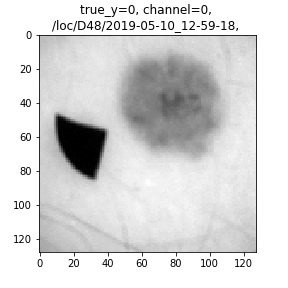
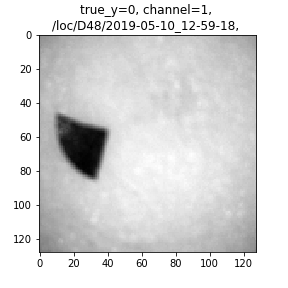
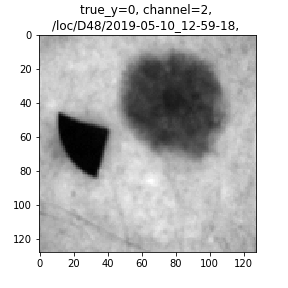
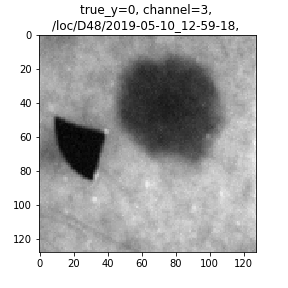
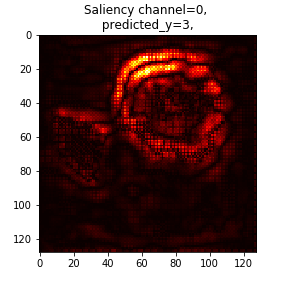
...
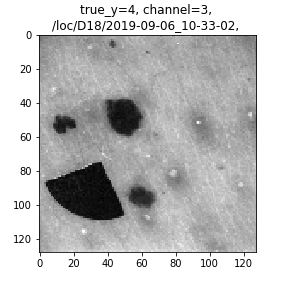
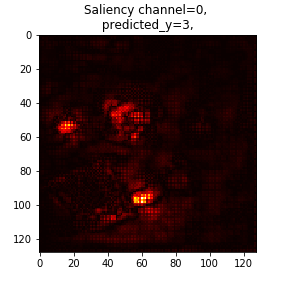
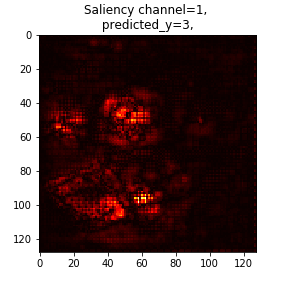
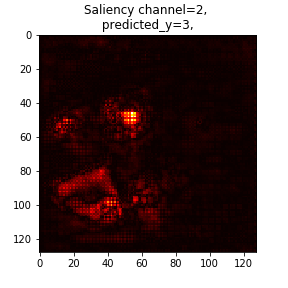
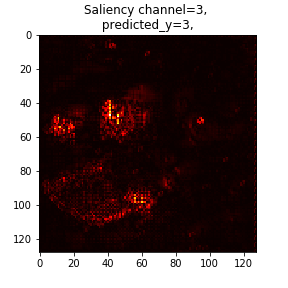

In [16]:
# Firstly 4 channels, then 4 channels of saliency map for winning class (which might be wrong! - check true_y Vs pred_y !)
display_gallery(X_list, y_list, paths_list)